In [43]:
import json
from osgeo import gdal, osr
import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt
import matplotlib
import pandas as pd
import dask.dataframe as dd
import geopandas as gpd
from shapely.geometry import Point
from dateutil import parser
import datetime
import numpy as np
from scipy.ndimage.morphology import binary_erosion, binary_closing, binary_opening
import os
%matplotlib inline

In [44]:
# Provide path to the dataset directory and Planet .tiff satellite imagery (*_Visual.tiff) and the location.
# Use the same dataset directory structure as originally provided
# You can also change "max_length_ship" for matching AIS data and satellite imagery data

# ===CHANGE=THIS=== #
base_dir = "/media/dejan/hdd640/PIXEL_EO"
satellite_imagery = "20170914_190548_0f37_3B_Visual.tif"
location = "sf_bay" # "sf_bay" or "long_beach" -> select where does satellite_imagery come from
max_length_ship = 30
# ================= #

date_folder = parser.parse(satellite_imagery.split("_")[0])
date_folder = '{:%Y_%m_%d}'.format(date_folder)
visual_filename = os.path.join(base_dir, "planet_data", location, date_folder, satellite_imagery)
udm_file = "_".join(os.path.basename(visual_filename).split("_")[:-1]) + "_Analytic_DN_udm.tif"
mask_filename = os.path.join(os.path.dirname(visual_filename), udm_file)
json_file = "_".join(os.path.basename(visual_filename).split("_")[:-2]) + ".json"
json_filename = os.path.join(os.path.dirname(visual_filename), json_file)
ais_dirname = os.path.join(base_dir, "AIS_data/AIS_ASCII_by_UTM_Month", visual_filename.split("/")[-2].split("_")[0])
ais_filename = os.path.join(ais_dirname, "AIS_{}_{}.csv".format("_".join(visual_filename.split("/")[-2].split("_")[:2]),
                            "Zone10" if location == "sf_bay" else "Zone11"))

print("\x1b[31mSatellite imagery: \x1b[0m" + visual_filename)
print("\x1b[31mUDM file (cloud mask) \x1b[0m" + mask_filename)
print("\x1b[31mJSON file (metadata) \x1b[0m" + json_filename)
print("\x1b[31mAIS data: \x1b[0m" + ais_filename)

Satellite imagery: /media/dejan/hdd640/PIXEL_EO/planet_data/sf_bay/2017_09_14/20170914_190548_0f37_3B_Visual.tif
UDM file (cloud mask) /media/dejan/hdd640/PIXEL_EO/planet_data/sf_bay/2017_09_14/20170914_190548_0f37_3B_Analytic_DN_udm.tif
JSON file (metadata) /media/dejan/hdd640/PIXEL_EO/planet_data/sf_bay/2017_09_14/20170914_190548_0f37.json
AIS data: /media/dejan/hdd640/PIXEL_EO/AIS_data/AIS_ASCII_by_UTM_Month/2017/AIS_2017_09_Zone10.csv


In [45]:
# Open image with gdal
ds = gdal.Open(visual_filename)
xoff, a, b, yoff, d, e = ds.GetGeoTransform()

# Get projection information from source image
ds_proj = ds.GetProjectionRef()
ds_srs = osr.SpatialReference(ds_proj)

# Get the source image's geographic coordinate system (the 'GEOGCS' node of ds_srs)
geogcs = ds_srs.CloneGeogCS()

ais_src = osr.SpatialReference()
ais_src.SetWellKnownGeogCS("WGS84")
transform = osr.CoordinateTransformation(ais_src, ds_srs)

transform_tiff = osr.CoordinateTransformation(ds_srs, ais_src)
lrx = xoff + (ds.RasterXSize * a)
lry = yoff + (ds.RasterYSize * e)
lon1, lat1, _ = transform_tiff.TransformPoint(xoff, yoff)
lon2, lat2, _ = transform_tiff.TransformPoint(lrx, lry)

with rasterio.open(visual_filename) as src:
    rgb = src.read([1, 2, 3])
print(rgb.shape)

with rasterio.open(mask_filename) as src:
    mask = src.read()
    
with open(json_filename, "r") as src:
    metadata = json.load(src)
    
print(mask.shape)
print(metadata)

(3, 4265, 8370)
(1, 4265, 8370)
{'_links': {'_self': 'https://api.planet.com/data/v1/item-types/PSScene3Band/items/20170914_190548_0f37', 'assets': 'https://api.planet.com/data/v1/item-types/PSScene3Band/items/20170914_190548_0f37/assets/', 'thumbnail': 'https://tiles.planet.com/data/v1/item-types/PSScene3Band/items/20170914_190548_0f37/thumb'}, '_permissions': ['assets.analytic_xml:download', 'assets.basic_analytic_dn:download', 'assets.basic_analytic_dn_xml:download', 'assets.basic_analytic_xml:download', 'assets.analytic_dn:download', 'assets.basic_udm:download', 'assets.analytic:download', 'assets.visual:download', 'assets.analytic_dn_xml:download', 'assets.basic_analytic_rpc:download', 'assets.basic_analytic_dn_rpc:download', 'assets.visual_xml:download', 'assets.basic_analytic:download', 'assets.udm:download'], 'geometry': {'coordinates': [[[-122.55828922098677, 37.764039455745575], [-122.53981537409379, 37.69553863581099], [-122.27346422897588, 37.74109674191905], [-122.29212665

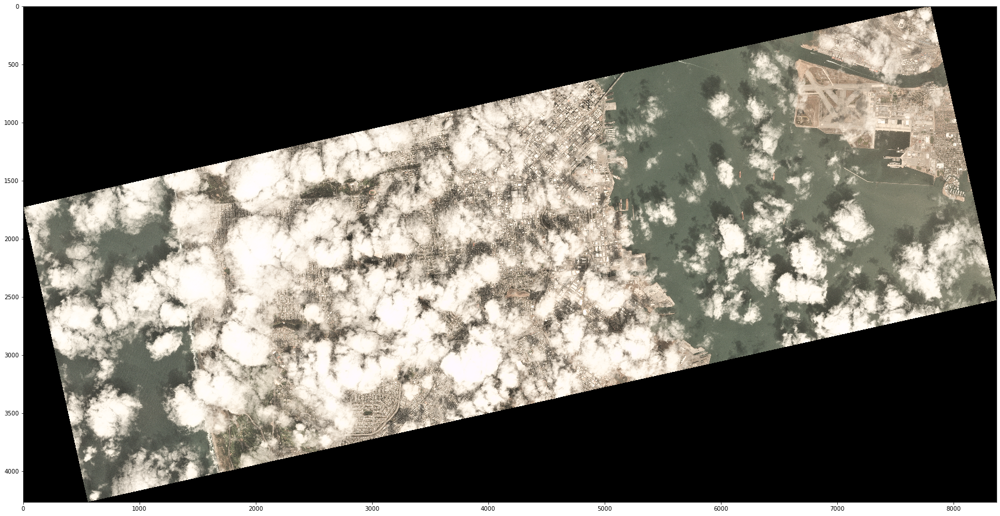

In [46]:
fig, ax = plt.subplots(figsize=(30, 30))
show(rgb, ax=ax)

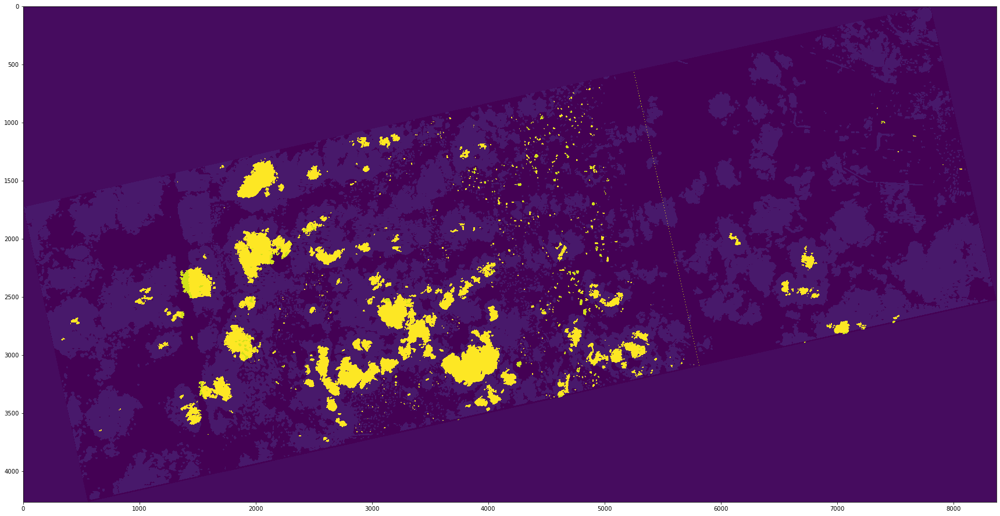

In [47]:
fig, ax = plt.subplots(figsize=(30, 30))
show(mask, ax=ax)

In [48]:
# https://github.com/planetlabs/notebooks/blob/master/jupyter-notebooks/udm/udm.ipynb
def udm_to_mask_cloud(udm_array):
    test_bits = int('00000011',2)
    bit_matches = udm_array & test_bits
    return bit_matches != 0

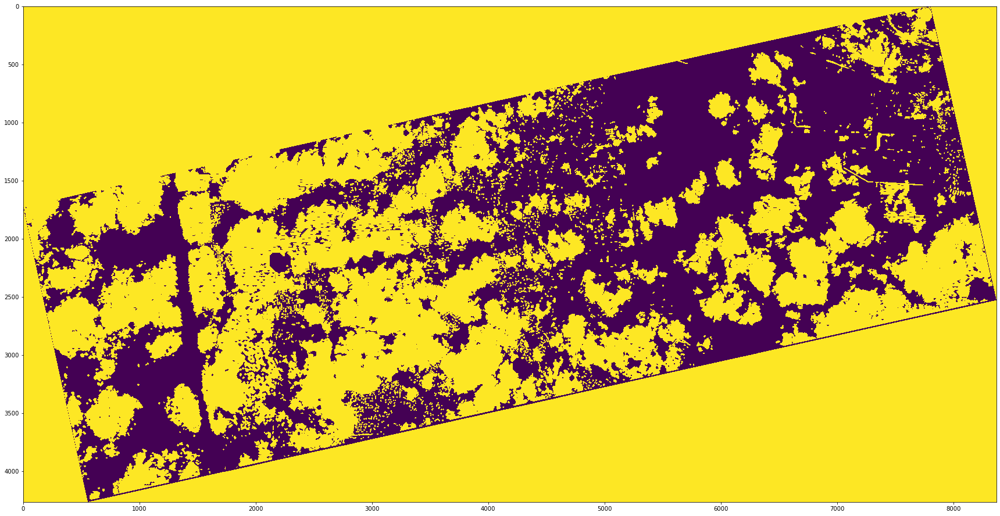

In [49]:
mask_cloud = udm_to_mask_cloud(mask)
fig, ax = plt.subplots(figsize=(30, 30))
show(mask_cloud, ax=ax)

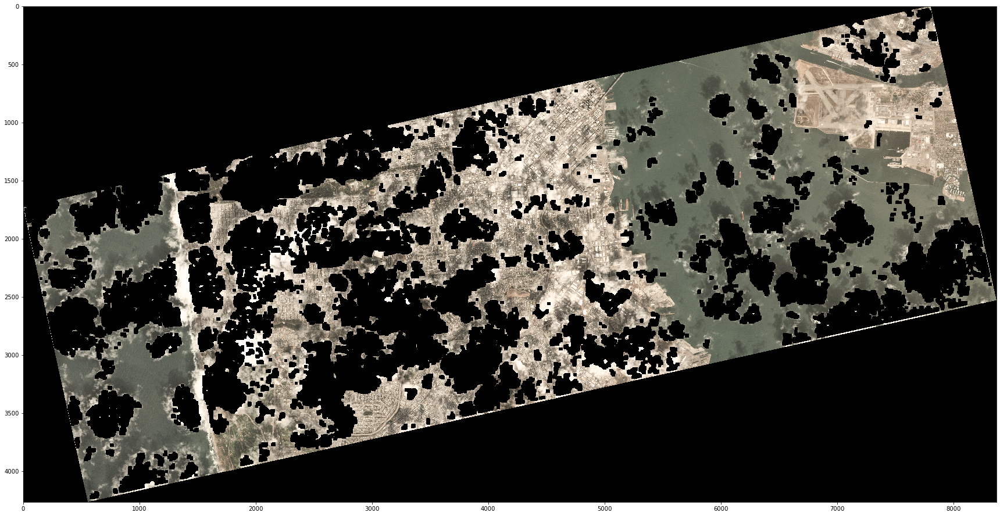

In [50]:
mask_cloud_eroded = binary_closing(mask_cloud, structure=np.ones((1,50,50)).astype(mask_cloud.dtype))
mask_cloud_eroded = binary_opening(mask_cloud, structure=np.ones((1,25,25)).astype(mask_cloud.dtype))
mask_cloud_free = rgb * np.repeat(~mask_cloud_eroded, 3, axis=0)
fig, ax = plt.subplots(figsize=(30, 30))
show(mask_cloud_free, ax=ax)

In [51]:
# load AIS data
df = pd.read_csv(ais_filename)
#df = dd.read_csv(ais_filename)
df["BaseDateTime"] = pd.to_datetime(df["BaseDateTime"])
#df.sort_values(by=["BaseDateTime"])
df.head()

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo
0,316005495,2017-09-01 00:00:02,49.19843,-123.10147,0.0,-143.8,511.0,STORM BREEZE,NaN,CY7471,1025.0,under way using engine,19.29,6.22,NaN,NaN
1,366771550,2017-09-01 00:00:00,37.92729,-122.46756,33.8,-110.5,301.0,NAPA,IMO8643004,WDE8110,1012.0,under way using engine,42.67,11.50,NaN,NaN
2,563234000,2017-09-01 00:00:00,34.90534,-121.19938,18.8,-80.1,329.0,NaN,NaN,NaN,NaN,under way using engine,NaN,NaN,NaN,NaN
3,367499170,2017-09-01 00:00:01,44.36732,-124.18077,6.4,12.9,511.0,ROYAL MARINER,NaN,WDF8843,1001.0,NaN,NaN,NaN,NaN,NaN
4,316005721,2017-09-01 00:00:04,49.31099,-123.10684,0.1,-201.9,511.0,CHARLES H CATES I,IMO8703218,NaN,1025.0,under way using engine,24.39,8.84,NaN,NaN


In [52]:
# filter by time
start_time = (parser.parse(metadata["properties"]["acquired"]) - datetime.timedelta(minutes=2)).replace(tzinfo=None)
print(start_time)
end_time = (parser.parse(metadata["properties"]["acquired"]) + datetime.timedelta(minutes=2)).replace(tzinfo=None)
print(end_time)
df_subset = df[(df["BaseDateTime"] > start_time) & (df["BaseDateTime"] < end_time)]
df_subset = df_subset.loc[df_subset["Length"] > max_length_ship]
df_subset = df_subset[df_subset["Status"] != "under way using engine"]
df_subset

2017-09-14 19:03:48.617740
2017-09-14 19:07:48.617740


,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo
11503368,377039001,2017-09-14 19:04:44,48.67083,-123.40633,0.0,-109.3,64.0,GRAN FINALE,IMO9022180,J8Y2969,37.0,moored,45.00,10.00,2.2,37.0
11503709,367362580,2017-09-14 19:04:23,49.56647,-124.37452,8.9,115.2,115.0,DETERMINED,IMO0600071,WDE5138,0.0,moored,33.00,7.00,0.0,0.0
11503809,316028554,2017-09-14 19:04:02,49.30628,-123.08634,11.5,201.7,200.0,BURRARD OTTER II,IMO9688180,CFN6722,1012.0,moored,34.29,12.64,NaN,NaN
11504073,366375000,2017-09-14 19:04:32,37.79350,-122.30033,0.0,79.0,272.0,MAUI,IMO7602338,WSLH,1004.0,moored,219.62,29.04,NaN,NaN
11504075,366767140,2017-09-14 19:04:46,47.65462,-122.36574,0.0,50.5,208.0,GARTH FOSS,IMO9070266,WCE4732,1025.0,moored,47.24,14.63,NaN,NaN
11504160,369081000,2017-09-14 19:04:32,46.20154,-123.38739,0.0,0.0,241.0,GULF CAJUN,IMO7511981,WDE2831,1025.0,moored,39.17,10.98,NaN,NaN
11504264,355521000,2017-09-14 19:04:19,49.29972,-123.18867,0.0,191.0,276.0,NEW DESTINY,IMO9405435,3EMP8,1004.0,at anchor,189.90,32.26,12.3,79.0
11504648,538006161,2017-09-14 19:04:28,49.33313,-123.22002,0.1,-119.5,127.0,ORWELL,IMO9472751,V7KG8,1024.0,at anchor,183.32,32.22,NaN,NaN
11504730,367732430,2017-09-14 19:04:48,48.36856,-124.61316,0.0,68.9,348.0,DENISE FOSS,IMO9748576,WDI7810,1025.0,moored,39.62,NaN,NaN,NaN
11504791,369970147,2017-09-14 19:04:19,47.63117,-122.38217,0.0,-193.6,178.0,BELL M SHIMADA,IMO9349069,WTED,1020.0,moored,63.57,15.00,NaN,NaN


In [53]:
# creating a geometry column
geometry = [Point(xy) for xy in zip(df_subset["LON"], df_subset["LAT"])]
# Coordinate reference system : WGS84
crs = {"init": "epsg:4326"}
# Creating a Geographic data frame
gdf = gpd.GeoDataFrame(df_subset, crs=crs, geometry=geometry)
# filter by bbox
gdf_subset = gdf.cx[lon1:lon2, lat1:lat2]
# compute mean value for location data (multiple measurements)
gdf_subset_mean = gdf_subset[["MMSI", "LAT", "LON", "Length"]].groupby(["MMSI"]).mean()
gdf_subset

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo,geometry
11504073,366375000,2017-09-14 19:04:32,37.79350,-122.30033,0.0,79.0,272.0,MAUI,IMO7602338,WSLH,1004.0,moored,219.62,29.04,NaN,NaN,POINT (-122.30033 37.7935)
11504807,303943000,2017-09-14 19:05:19,37.77194,-122.30225,0.0,0.0,275.0,CAPE HENRY,IMO7724083,KMJH,1004.0,moored,228.51,32.31,NaN,NaN,POINT (-122.30225 37.77194)
11505416,338048555,2017-09-14 19:07:34,37.79889,-122.33682,0.1,-159.9,511.0,DUTRA DB 24,IMO8758378,WCW6340,1005.0,restricted maneuverability,45.72,16.50,NaN,NaN,POINT (-122.33682 37.79889)
11508014,367833000,2017-09-14 19:05:21,37.74844,-122.37962,0.0,-129.7,266.0,CAPELLA,IMO7223508,NBXO,1018.0,moored,288.40,32.26,NaN,NaN,POINT (-122.37962 37.74844)
11514085,366565000,2017-09-14 19:04:01,37.77341,-122.30259,0.0,3.1,93.0,KEYSTONE STATE,IMO6605022,WCJI,1004.0,undefined,203.82,23.22,10.2,70.0,POINT (-122.30259 37.77341)
15221077,538002271,2017-09-14 19:04:05,37.76158,-122.34767,0.0,-182.6,171.0,SEAWAYS REYMAR,IMO9275749,V7HN9,1024.0,at anchor,229.21,32.22,NaN,NaN,POINT (-122.34767 37.76158)
15221250,566739000,2017-09-14 19:06:37,37.77094,-122.34822,0.1,-82.0,181.0,NORD STEADY,IMO9629706,S6ME7,1024.0,at anchor,183.00,32.23,NaN,NaN,POINT (-122.34822 37.77094)
15221350,373889000,2017-09-14 19:04:03,37.76008,-122.33528,0.0,122.8,192.0,GLOBAL GOLD,IMO9614359,3FHS7,1004.0,at anchor,172.39,28.80,9.8,70.0,POINT (-122.33528 37.76008)
15222455,368992000,2017-09-14 19:05:19,37.74803,-122.38330,0.0,-142.0,266.0,ALGOL,IMO7303205,NAMW,1018.0,moored,288.40,32.26,NaN,NaN,POINT (-122.3833 37.74803)
15222894,308664000,2017-09-14 19:07:30,37.74132,-122.34528,0.0,-103.6,191.0,OKLAHOMA,IMO9321964,C6VR8,1024.0,at anchor,237.71,42.03,14.8,80.0,POINT (-122.34528 37.74132)


In [54]:
def transform_lat_lng(lon, lat, transform):
    x, y = [], []
    n_coord = len(lon)
    for i in range(n_coord):
        proj_x, proj_y, _ = transform.TransformPoint(lon[i], lat[i])
        x.append((int)(((proj_x - xoff) / a)))
        y.append((int)(((proj_y - yoff) / e)))
    return np.array(x), np.array(y)

In [55]:
def prepare_rects(x, y, lengths, metadata, img, cloud_mask, thresh):
    patches = []
    colors = []
    patches_real = []
    ratios = []
    for c_x, c_y, length in zip(x, y, lengths):
        length_pix = int(length/float(metadata["properties"]["gsd"]))
        patch = img[:, max(0, c_y-length_pix):min(c_y+length_pix, cloud_mask.shape[1]), max(0, c_x-length_pix):min(c_x+length_pix, cloud_mask.shape[2])]
        patch_mask = cloud_mask[:, max(0, c_y-length_pix):min(c_y+length_pix, cloud_mask.shape[1]), max(0, c_x-length_pix):min(c_x+length_pix, cloud_mask.shape[2])].astype(int)
        ratios.append(patch_mask.flatten().sum() / (patch_mask.shape[1] * patch_mask.shape[2]))        
        patches.append(plt.Rectangle((c_x - length_pix, c_y - length_pix), length_pix * 2, length_pix * 2))
        colors.append("yellow" if ratios[-1] < thresh else "red")
        patches_real.append(patch)
        
    return patches, ratios, colors, patches_real

[0.0, 1.0, 0.0, 0.05032753842277652, 0.10938934802571167, 1.0, 0.0, 0.006785810266057512, 0.0, 0.0, 0.32484375, 0.29921875, 0.9439791760977818, 0.27988338192419826, 0.858025494276795, 1.0, 0.0, 0.8414005157706804, 0.0, 0.12009419152276295, 0.15047871000251953]


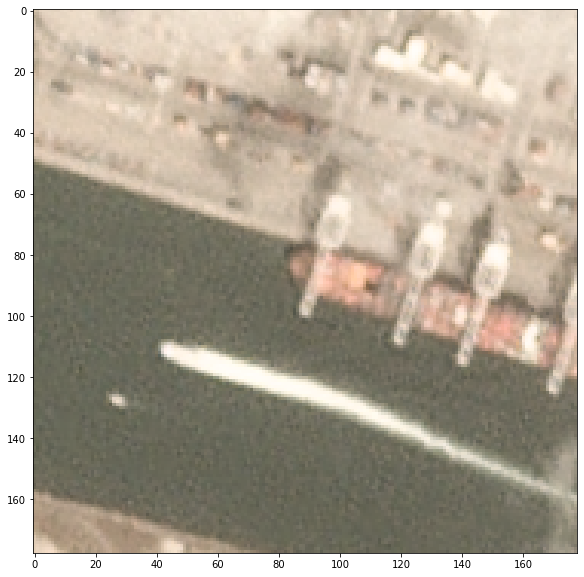

In [56]:
x, y = transform_lat_lng(gdf_subset_mean["LON"].values, gdf_subset_mean["LAT"].values, transform)
patches, ratios, colors, patches_real = prepare_rects(x, y, gdf_subset_mean["Length"], metadata, mask_cloud_free, mask_cloud_eroded, 0.2)
print(ratios)
fig, ax = plt.subplots(figsize=(10, 10))
show(patches_real[0], ax=ax)

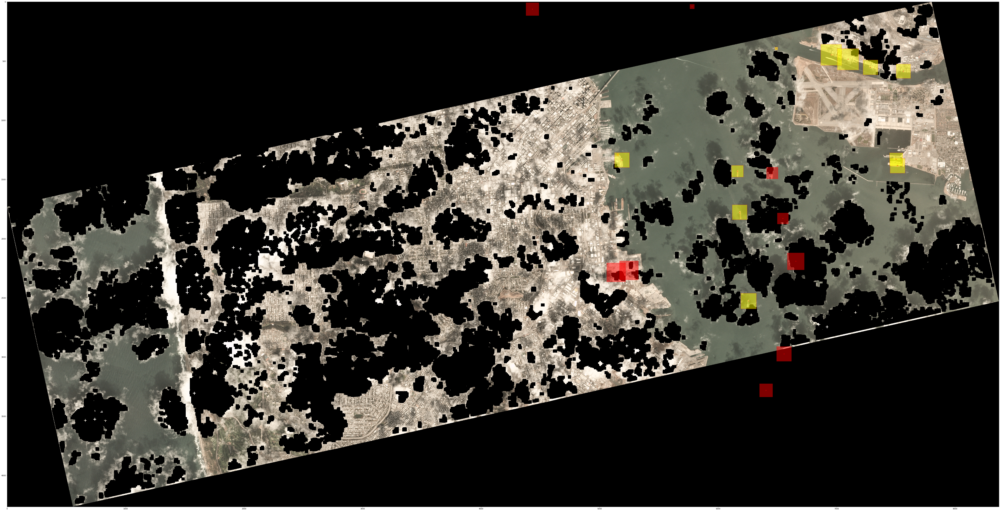

In [57]:
fig, ax = plt.subplots(figsize=(100, 100))
show(mask_cloud_free, ax=ax)
ax.plot(x,y,"r+")
coll = matplotlib.collections.PatchCollection(patches, facecolor=colors, edgecolor="red", alpha=0.5)
ax.add_collection(coll)